In [ ]:
import pandas as pd
from functools import reduce
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
games = pd.read_csv("games.csv")
pff = pd.read_csv("pffScoutingData.csv")
players = pd.read_csv("players.csv")
plays = pd.read_csv("plays.csv")

In [ ]:
games

,gameId,season,week,gameDate,gameTimeEastern,homeTeamAbbr,visitorTeamAbbr
0,2021090900,2021,1,09/09/2021,20:20:00,TB,DAL
1,2021091200,2021,1,09/12/2021,13:00:00,ATL,PHI
2,2021091201,2021,1,09/12/2021,13:00:00,BUF,PIT
3,2021091202,2021,1,09/12/2021,13:00:00,CAR,NYJ
4,2021091203,2021,1,09/12/2021,13:00:00,CIN,MIN
...,...,...,...,...,...,...,...
117,2021103109,2021,8,10/31/2021,16:05:00,SEA,JAX
118,2021103110,2021,8,10/31/2021,16:25:00,DEN,WAS
119,2021103111,2021,8,10/31/2021,16:25:00,NO,TB
120,2021103112,2021,8,10/31/2021,20:20:00,MIN,DAL


In [ ]:
null_counts = games.isnull().sum()
null_counts

gameId             0
season             0
week               0
gameDate           0
gameTimeEastern    0
homeTeamAbbr       0
visitorTeamAbbr    0
dtype: int64

In [ ]:
null_counts = players.isnull().sum()
null_counts


nflId                 0
height                0
weight                0
birthDate           232
collegeName         224
officialPosition      0
displayName           0
dtype: int64

In [ ]:
players['birthDate'].fillna('1900-01-01', inplace=True)
players['collegeName'].fillna('Unknown', inplace=True)

In [ ]:
null_counts = pff.isnull().sum()
null_counts

gameId                         0
playId                         0
nflId                          0
pff_role                       0
pff_positionLinedUp            0
pff_hit                    94127
pff_hurry                  94127
pff_sack                   94127
pff_beatenByDefender      140167
pff_hitAllowed            140167
pff_hurryAllowed          140167
pff_sackAllowed           140167
pff_nflIdBlockedPlayer    141728
pff_blockType             140350
pff_backFieldBlock        140351
dtype: int64

In [ ]:
pff

,gameId,playId,nflId,pff_role,pff_positionLinedUp,pff_hit,pff_hurry,pff_sack,pff_beatenByDefender,pff_hitAllowed,pff_hurryAllowed,pff_sackAllowed,pff_nflIdBlockedPlayer,pff_blockType,pff_backFieldBlock
0,2021090900,97,25511,Pass,QB,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2021090900,97,35481,Pass Route,TE-L,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2021090900,97,35634,Pass Route,LWR,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2021090900,97,39985,Pass Route,HB-R,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2021090900,97,40151,Pass Block,C,NaN,NaN,NaN,0.0,0.0,0.0,0.0,44955.0,SW,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
188249,2021110100,4433,52507,Pass Block,LT,NaN,NaN,NaN,0.0,0.0,1.0,0.0,43338.0,PP,0.0
188250,2021110100,4433,52546,Coverage,SCBoR,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
188251,2021110100,4433,52573,Pass Route,SLoWR,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
188252,2021110100,4433,52585,Pass Rush,LEO,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
columns_to_replace = ['pff_hit', 'pff_hurry', 'pff_sack', 'pff_beatenByDefender', 'pff_hitAllowed', 'pff_hurryAllowed',
                      'pff_sackAllowed', 'pff_nflIdBlockedPlayer', 'pff_blockType', 'pff_backFieldBlock']

pff.loc[:, columns_to_replace] = pff.loc[:, columns_to_replace].fillna(0.0)

In [ ]:
pff

,gameId,playId,nflId,pff_role,pff_positionLinedUp,pff_hit,pff_hurry,pff_sack,pff_beatenByDefender,pff_hitAllowed,pff_hurryAllowed,pff_sackAllowed,pff_nflIdBlockedPlayer,pff_blockType,pff_backFieldBlock
0,2021090900,97,25511,Pass,QB,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2021090900,97,35481,Pass Route,TE-L,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2021090900,97,35634,Pass Route,LWR,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,2021090900,97,39985,Pass Route,HB-R,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,2021090900,97,40151,Pass Block,C,0.0,0.0,0.0,0.0,0.0,0.0,0.0,44955.0,SW,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
188249,2021110100,4433,52507,Pass Block,LT,0.0,0.0,0.0,0.0,0.0,1.0,0.0,43338.0,PP,0.0
188250,2021110100,4433,52546,Coverage,SCBoR,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
188251,2021110100,4433,52573,Pass Route,SLoWR,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
188252,2021110100,4433,52585,Pass Rush,LEO,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
null_counts = plays.isnull().sum()
null_counts

gameId                       0
playId                       0
playDescription              0
quarter                      0
down                         0
yardsToGo                    0
possessionTeam               0
defensiveTeam                0
yardlineSide               125
yardlineNumber               0
gameClock                    0
preSnapHomeScore             0
preSnapVisitorScore          0
passResult                   0
penaltyYards              7801
prePenaltyPlayResult         0
playResult                   0
foulName1                 7821
foulNFLId1                7821
foulName2                 8527
foulNFLId2                8527
foulName3                 8556
foulNFLId3                8556
absoluteYardlineNumber       1
offenseFormation             7
personnelO                   1
defendersInBox               7
personnelD                   1
dropBackType               528
pff_playAction               0
pff_passCoverage             0
pff_passCoverageType         0
dtype: i

In [ ]:
columns_to_replace = ['yardlineSide','penaltyYards', 'foulName1', 'foulNFLId1', 'foulName2', 'foulNFLId2', 'foulName3',
                      'foulNFLId3', 'absoluteYardlineNumber', 'offenseFormation', 'personnelO','defendersInBox','personnelD','dropBackType']

plays.loc[:, columns_to_replace] = plays.loc[:, columns_to_replace].fillna(0.0)

In [ ]:
week1['week_number'] = "1"
week2['week_number'] = "2"
week3['week_number'] = "3"
week4['week_number'] = "4"
week5['week_number'] = "5"
week6['week_number'] = "6"
week7['week_number'] = "7"
week8['week_number'] = "8"

In [ ]:
week1

In [ ]:
data_frames = [week1, week2, week3, week4, week5, week6, week7, week8]

# Concatenate the DataFrames vertically
merged_df = pd.concat(data_frames)

In [ ]:
merged_df

In [ ]:
null_counts = merged_df.isnull().sum()
null_counts

In [ ]:
columns_to_replace = ['nflId','jerseyNumber', 'o', 'dir']

merged_df.loc[:, columns_to_replace] = merged_df.loc[:, columns_to_replace].fillna(0.0)

In [ ]:
game_play = games.merge(plays,on=['gameId'])

In [ ]:
players

In [ ]:
pd.set_option('display.max_columns', None)
plays.style

In [ ]:
merged_df

In [ ]:
game_play['gameClock'] = pd.to_datetime(game_play['gameClock'], format='%M:%S').dt.time

In [ ]:
column_dtype = game_play['gameClock'].dtype
print(column_dtype)

object


In [ ]:
game_play

,gameId,season,week,gameDate,gameTimeEastern,homeTeamAbbr,visitorTeamAbbr,playId,playDescription,quarter,...,foulNFLId3,absoluteYardlineNumber,offenseFormation,personnelO,defendersInBox,personnelD,dropBackType,pff_playAction,pff_passCoverage,pff_passCoverageType
0,2021090900,2021,1,09/09/2021,20:20:00,TB,DAL,97,(13:33) (Shotgun) T.Brady pass incomplete deep...,1,...,0.0,43.0,SHOTGUN,"1 RB, 1 TE, 3 WR",6.0,"4 DL, 2 LB, 5 DB",TRADITIONAL,0,Cover-1,Man
1,2021090900,2021,1,09/09/2021,20:20:00,TB,DAL,137,(13:18) (Shotgun) D.Prescott pass deep left to...,1,...,0.0,108.0,EMPTY,"1 RB, 2 TE, 2 WR",6.0,"4 DL, 4 LB, 3 DB",TRADITIONAL,0,Cover-3,Zone
2,2021090900,2021,1,09/09/2021,20:20:00,TB,DAL,187,(12:23) (Shotgun) D.Prescott pass short middle...,1,...,0.0,76.0,SHOTGUN,"0 RB, 2 TE, 3 WR",6.0,"3 DL, 3 LB, 5 DB",TRADITIONAL,0,Cover-3,Zone
3,2021090900,2021,1,09/09/2021,20:20:00,TB,DAL,282,(9:56) D.Prescott pass incomplete deep left to...,1,...,0.0,49.0,SINGLEBACK,"1 RB, 2 TE, 2 WR",6.0,"4 DL, 3 LB, 4 DB",TRADITIONAL,1,Cover-3,Zone
4,2021090900,2021,1,09/09/2021,20:20:00,TB,DAL,349,(9:46) (Shotgun) D.Prescott pass incomplete sh...,1,...,0.0,54.0,SHOTGUN,"1 RB, 1 TE, 3 WR",7.0,"3 DL, 4 LB, 4 DB",TRADITIONAL,0,Cover-3,Zone
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8552,2021110100,2021,8,11/01/2021,20:15:00,KC,NYG,4310,(1:56) (Shotgun) P.Mahomes sacked at NYG 16 fo...,4,...,0.0,18.0,SHOTGUN,"1 RB, 1 TE, 3 WR",4.0,"1 DL, 3 LB, 7 DB",SCRAMBLE,0,Bracket,Other
8553,2021110100,2021,8,11/01/2021,20:15:00,KC,NYG,4363,(1:07) (Shotgun) D.Jones pass short right to E...,4,...,0.0,35.0,SHOTGUN,"1 RB, 1 TE, 3 WR",5.0,"4 DL, 1 LB, 6 DB",SCRAMBLE,0,Cover-2,Zone
8554,2021110100,2021,8,11/01/2021,20:15:00,KC,NYG,4392,"(1:01) (No Huddle, Shotgun) D.Jones sacked at ...",4,...,0.0,38.0,SHOTGUN,"1 RB, 1 TE, 3 WR",6.0,"4 DL, 1 LB, 6 DB",TRADITIONAL,0,Cover-2,Zone
8555,2021110100,2021,8,11/01/2021,20:15:00,KC,NYG,4411,"(:39) (No Huddle, Shotgun) D.Jones pass incomp...",4,...,0.0,30.0,SHOTGUN,"1 RB, 1 TE, 3 WR",5.0,"4 DL, 1 LB, 6 DB",TRADITIONAL,0,Cover-2,Zone


In [ ]:
# Filter plays for the fourth quarter
end_time = game_play.loc[game_play['quarter'] == 4, 'gameClock'].min()
end_time

datetime.time(0, 0, 1)

In [ ]:
end_time = game_play.loc[game_play['gameId'] == 2021090900].loc[game_play['quarter'] == 4, 'gameClock'].min()
end_time

datetime.time(0, 0, 10)

In [ ]:
def determine_winner(group):
    end_time = group.loc[group['quarter'] == 4, 'gameClock'].min()
    end_scores = group.loc[(group['gameClock'] == end_time) & (group['quarter'] == 4), ['preSnapHomeScore', 'preSnapVisitorScore']].iloc[0]
    print(end_time)
    print(end_scores)

    if end_scores['preSnapHomeScore'] > end_scores['preSnapVisitorScore']:
        winner = game_play['homeTeamAbbr']
    elif end_scores['preSnapHomeScore'] < end_scores['preSnapVisitorScore']:
        winner = game_play['visitorTeamAbbr']
    else:
        winner = 'Tie'

    group['winner'] = winner
    return group

# Apply the determine_winner function to each group based on game ID
game_play = game_play.groupby('gameId').apply(determine_winner)

00:00:10
preSnapHomeScore       28
preSnapVisitorScore    29
Name: 96, dtype: int64
00:03:19
preSnapHomeScore        6
preSnapVisitorScore    29
Name: 168, dtype: int64
00:00:54
preSnapHomeScore       13
preSnapVisitorScore    23
Name: 250, dtype: int64
00:01:56
preSnapHomeScore       19
preSnapVisitorScore    14
Name: 322, dtype: int64
00:00:19
preSnapHomeScore       24
preSnapVisitorScore    21
Name: 389, dtype: int64
00:00:17
preSnapHomeScore       33
preSnapVisitorScore    41
Name: 487, dtype: int64
00:00:09
preSnapHomeScore       37
preSnapVisitorScore    14
Name: 566, dtype: int64
00:00:24
preSnapHomeScore       16
preSnapVisitorScore    28
Name: 630, dtype: int64
00:08:18
preSnapHomeScore       13
preSnapVisitorScore    38
Name: 697, dtype: int64
00:01:50
preSnapHomeScore       16
preSnapVisitorScore    20
Name: 768, dtype: int64
00:01:16
preSnapHomeScore       33
preSnapVisitorScore    29
Name: 834, dtype: int64
00:04:15
preSnapHomeScore       16
preSnapVisitorScore    17
Name:

<ipython-input-19-79cb0ce5029c>:18: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  game_play = game_play.groupby('gameId').apply(determine_winner)


In [ ]:
game_play.style

,gameId,season,week,gameDate,gameTimeEastern,homeTeamAbbr,visitorTeamAbbr,playId,playDescription,quarter,down,yardsToGo,possessionTeam,defensiveTeam,yardlineSide,yardlineNumber,gameClock,preSnapHomeScore,preSnapVisitorScore,passResult,penaltyYards,prePenaltyPlayResult,playResult,foulName1,foulNFLId1,foulName2,foulNFLId2,foulName3,foulNFLId3,absoluteYardlineNumber,offenseFormation,personnelO,defendersInBox,personnelD,dropBackType,pff_playAction,pff_passCoverage,pff_passCoverageType,winner
0,2021090900,2021,1,09/09/2021,20:20:00,TB,DAL,97,(13:33) (Shotgun) T.Brady pass incomplete deep right to C.Godwin.,1,3,2,TB,DAL,TB,33,00:13:33,0,0,I,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,43.000000,SHOTGUN,"1 RB, 1 TE, 3 WR",6.000000,"4 DL, 2 LB, 5 DB",TRADITIONAL,0,Cover-1,Man,DAL
1,2021090900,2021,1,09/09/2021,20:20:00,TB,DAL,137,(13:18) (Shotgun) D.Prescott pass deep left to A.Cooper pushed ob at DAL 30 for 28 yards (A.Winfield).,1,1,10,DAL,TB,DAL,2,00:13:18,0,0,C,0.000000,28,28,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,108.000000,EMPTY,"1 RB, 2 TE, 2 WR",6.000000,"4 DL, 4 LB, 3 DB",TRADITIONAL,0,Cover-3,Zone,DAL
2,2021090900,2021,1,09/09/2021,20:20:00,TB,DAL,187,(12:23) (Shotgun) D.Prescott pass short middle to D.Schultz to DAL 39 for 5 yards (D.White).,1,2,6,DAL,TB,DAL,34,00:12:23,0,0,C,0.000000,5,5,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,76.000000,SHOTGUN,"0 RB, 2 TE, 3 WR",6.000000,"3 DL, 3 LB, 5 DB",TRADITIONAL,0,Cover-3,Zone,DAL
3,2021090900,2021,1,09/09/2021,20:20:00,TB,DAL,282,(9:56) D.Prescott pass incomplete deep left to C.Lamb.,1,1,10,DAL,TB,TB,39,00:09:56,0,0,I,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,49.000000,SINGLEBACK,"1 RB, 2 TE, 2 WR",6.000000,"4 DL, 3 LB, 4 DB",TRADITIONAL,1,Cover-3,Zone,DAL
4,2021090900,2021,1,09/09/2021,20:20:00,TB,DAL,349,(9:46) (Shotgun) D.Prescott pass incomplete short left to C.Lamb [L.David].,1,3,15,DAL,TB,TB,44,00:09:46,0,0,I,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,54.000000,SHOTGUN,"1 RB, 1 TE, 3 WR",7.000000,"3 DL, 4 LB, 4 DB",TRADITIONAL,0,Cover-3,Zone,DAL
5,2021090900,2021,1,09/09/2021,20:20:00,TB,DAL,410,(8:53) (Shotgun) T.Brady pass short middle to M.Evans to TB 21 for 10 yards (T.Diggs).,1,2,5,TB,DAL,TB,11,00:08:53,0,0,C,0.000000,10,10,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,21.000000,EMPTY,"1 RB, 1 TE, 3 WR",6.000000,"4 DL, 2 LB, 5 DB",TRADITIONAL,0,Cover-1,Man,DAL
6,2021090900,2021,1,09/09/2021,20:20:00,TB,DAL,434,"(8:24) (No Huddle, Shotgun) T.Brady pass incomplete short left to M.Evans.",1,1,10,TB,DAL,TB,21,00:08:24,0,0,I,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,31.000000,SHOTGUN,"1 RB, 1 TE, 3 WR",6.000000,"4 DL, 2 LB, 5 DB",TRADITIONAL,0,Cover-3,Zone,DAL
7,2021090900,2021,1,09/09/2021,20:20:00,TB,DAL,456,(8:20) (Shotgun) T.Brady pass deep middle to R.Gronkowski to TB 40 for 19 yards (D.Kazee).,1,2,10,TB,DAL,TB,21,00:08:20,0,0,C,0.000000,19,19,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,31.000000,SHOTGUN,"1 RB, 1 TE, 3 WR",6.000000,"4 DL, 2 LB, 5 DB",TRADITIONAL,0,Cover-6,Zone,DAL
8,2021090900,2021,1,09/09/2021,20:20:00,TB,DAL,480,"(7:53) (No Huddle, Shotgun) T.Brady pass deep right to A.Brown ran ob at DAL 32 for 28 yards (A.Brown).",1,1,10,TB,DAL,TB,40,00:07:53,0,0,C,0.000000,28,28,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,SHOTGUN,"1 RB, 1 TE, 3 WR",6.000000,"4 DL, 2 LB, 5 DB",TRADITIONAL,0,Cover-3,Zone,DAL
9,2021090900,2021,1,09/09/2021,20:20:00,TB,DAL,509,"(7:30) (No Huddle, Shotgun) T.Brady pass short right to A.Brown pushed ob at DAL 16 for 16 yards (A.Brown; K.Neal).",1,1,10,TB,DAL,DAL,32,00:07:30,0,0,C,0.000000,16,16,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,78.000000,SHOTGUN,"1 RB, 1 TE, 3 WR",6.000000,"4 DL, 2 LB, 5 DB",TRADITIONAL,0,Quarters,Zone,DAL


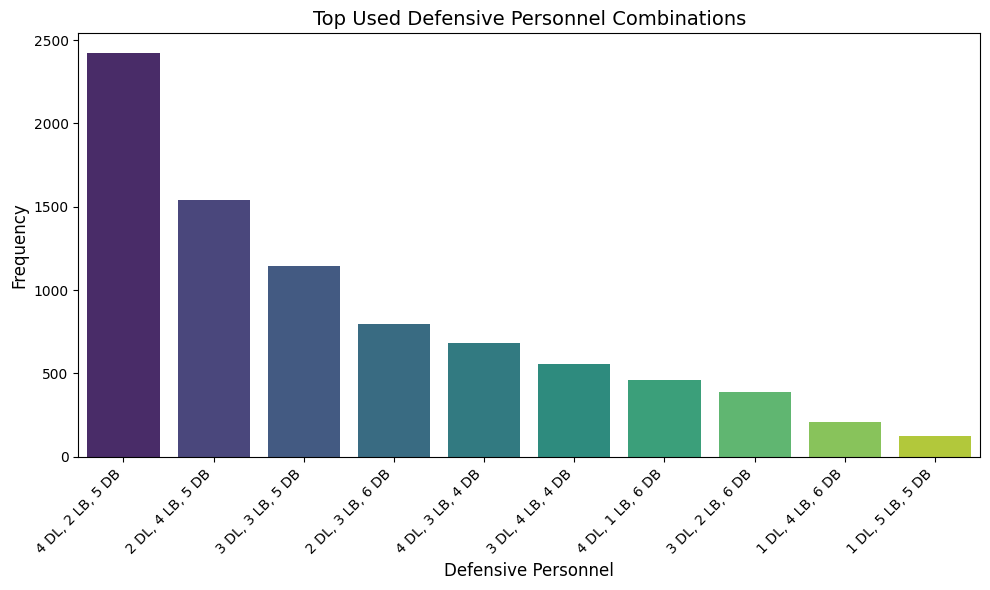

In [ ]:
top_defensive_personnel = game_play['personnelD'].value_counts().sort_values(ascending=False).head(10)
plt.figure(figsize=(10, 6))
sns.barplot(x=top_defensive_personnel.index, y=top_defensive_personnel.values, palette='viridis')

# Customize the plot
plt.xlabel('Defensive Personnel', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.title('Top Used Defensive Personnel Combinations', fontsize=14)
plt.xticks(rotation=45, ha='right')

# Display the plot
plt.tight_layout()
plt.show()

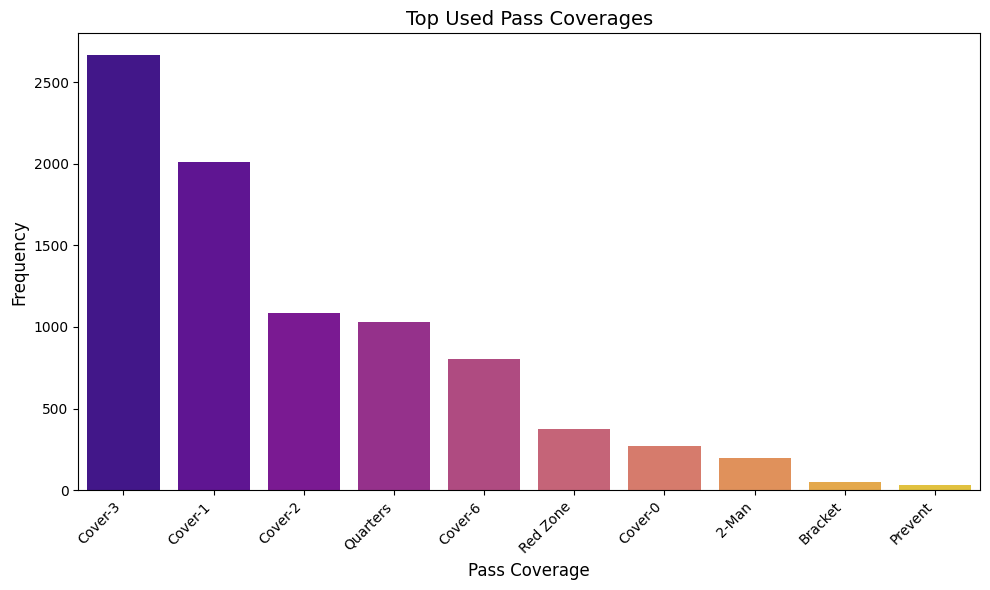

In [ ]:
top_pass_coverage = game_play['pff_passCoverage'].value_counts().sort_values(ascending=False).head(10)
plt.figure(figsize=(10, 6))
sns.barplot(x=top_pass_coverage.index, y=top_pass_coverage.values, palette='plasma')

# Customize the plot
plt.xlabel('Pass Coverage', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.title('Top Used Pass Coverages', fontsize=14)
plt.xticks(rotation=45, ha='right')

# Display the plot
plt.tight_layout()
plt.show()

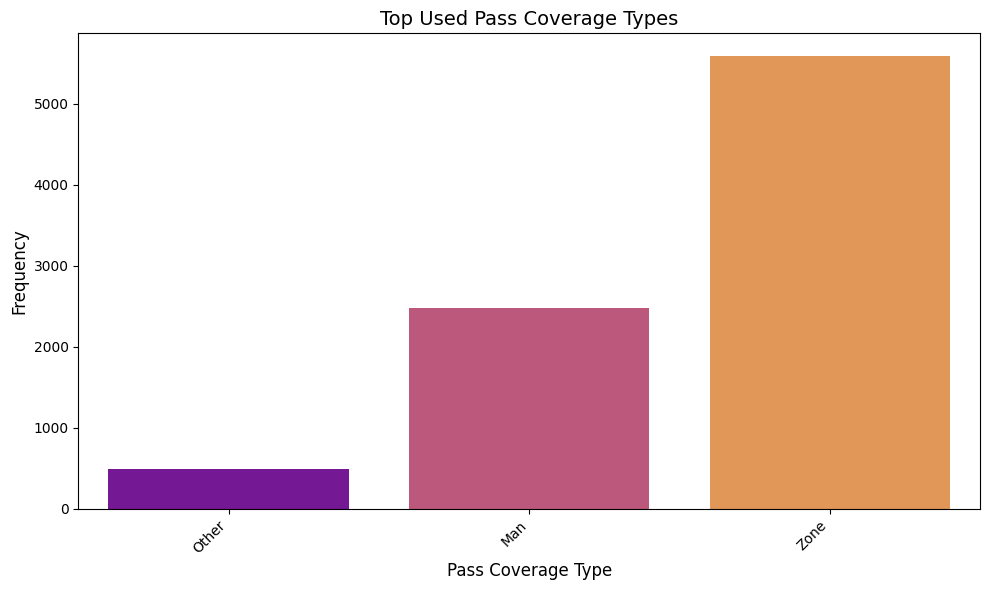

In [ ]:
top_pass_coverage_type = game_play['pff_passCoverageType'].value_counts().sort_values(ascending=True).head(10)
plt.figure(figsize=(10, 6))
sns.barplot(x=top_pass_coverage_type.index, y=top_pass_coverage_type.values, palette='plasma')

# Customize the plot
plt.xlabel('Pass Coverage Type', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.title('Top Used Pass Coverage Types', fontsize=14)
plt.xticks(rotation=45, ha='right')

# Display the plot
plt.tight_layout()
plt.show()

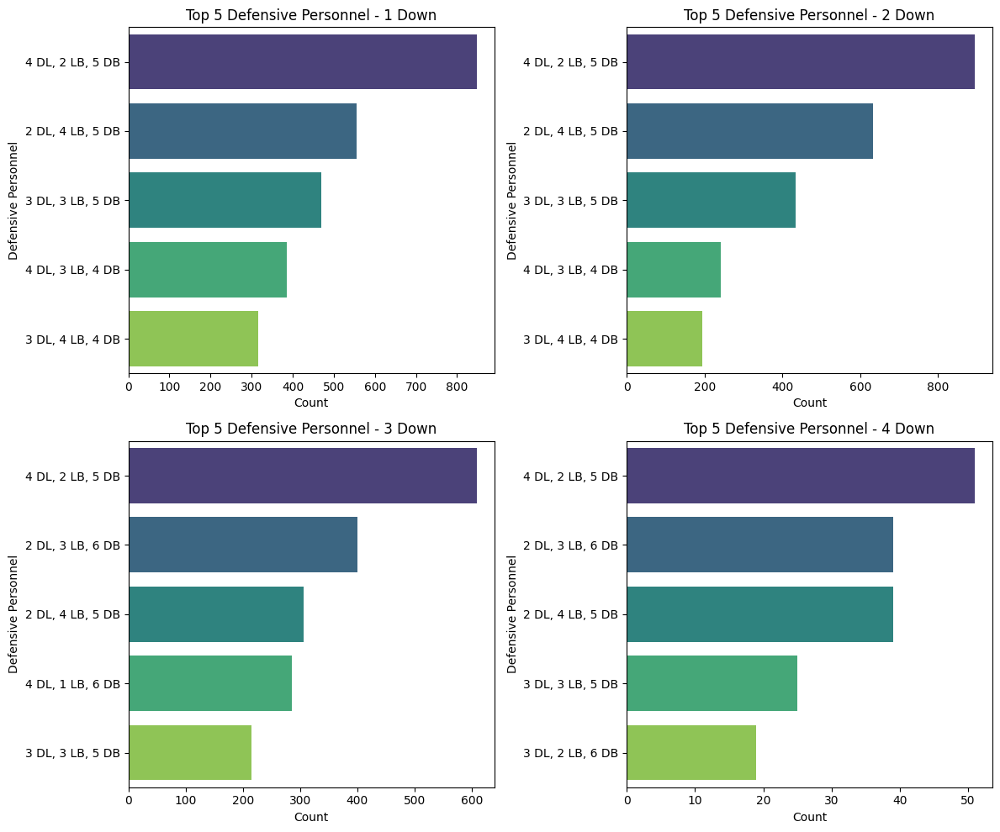

In [ ]:
# Define the downs of interest
downs = [1, 2, 3, 4]

# Create a subplot with 2 rows and 2 columns
fig, axes = plt.subplots(2, 2, figsize=(12, 10))

# Iterate over the downs and plot the top 5 personnel for each down
for i, down in enumerate(downs):
    # Filter the DataFrame for the current down
    down_df = game_play[game_play['down'] == down]

    # Get the top 5 personnel for the current down based on frequency
    top_5_personnel = down_df['personnelD'].value_counts().nlargest(5)

    # Create a bar plot using Seaborn
    sns.barplot(ax=axes[i // 2, i % 2], x=top_5_personnel.values, y=top_5_personnel.index, palette="viridis")

    # Customize the plot
    axes[i // 2, i % 2].set_title(f"Top 5 Defensive Personnel - {down} Down")
    axes[i // 2, i % 2].set_xlabel("Count")
    axes[i // 2, i % 2].set_ylabel("Defensive Personnel")

# Adjust the spacing between subplots
plt.tight_layout()

# Display the plot
plt.show()


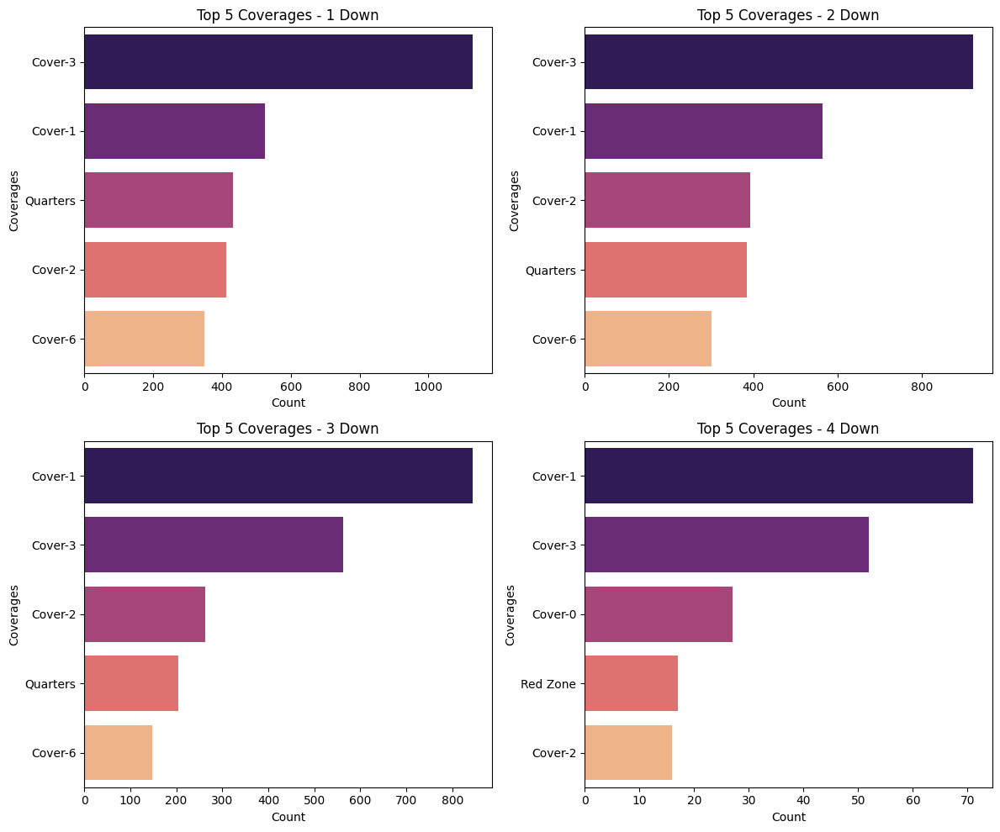

In [ ]:
# Define the downs of interest
downs = [1, 2, 3, 4]

# Create a subplot with 2 rows and 2 columns
fig, axes = plt.subplots(2, 2, figsize=(12, 10))

# Iterate over the downs and plot the top 5 personnel for each down
for i, down in enumerate(downs):
    # Filter the DataFrame for the current down
    down_df = game_play[game_play['down'] == down]

    # Get the top 5 personnel for the current down based on frequency
    top_5_coverage = down_df['pff_passCoverage'].value_counts().nlargest(5)

    # Create a bar plot using Seaborn
    sns.barplot(ax=axes[i // 2, i % 2], x=top_5_coverage.values, y=top_5_coverage.index, palette="magma")

    # Customize the plot
    axes[i // 2, i % 2].set_title(f"Top 5 Coverages - {down} Down")
    axes[i // 2, i % 2].set_xlabel("Count")
    axes[i // 2, i % 2].set_ylabel("Coverages")

# Adjust the spacing between subplots
plt.tight_layout()

# Display the plot
plt.show()


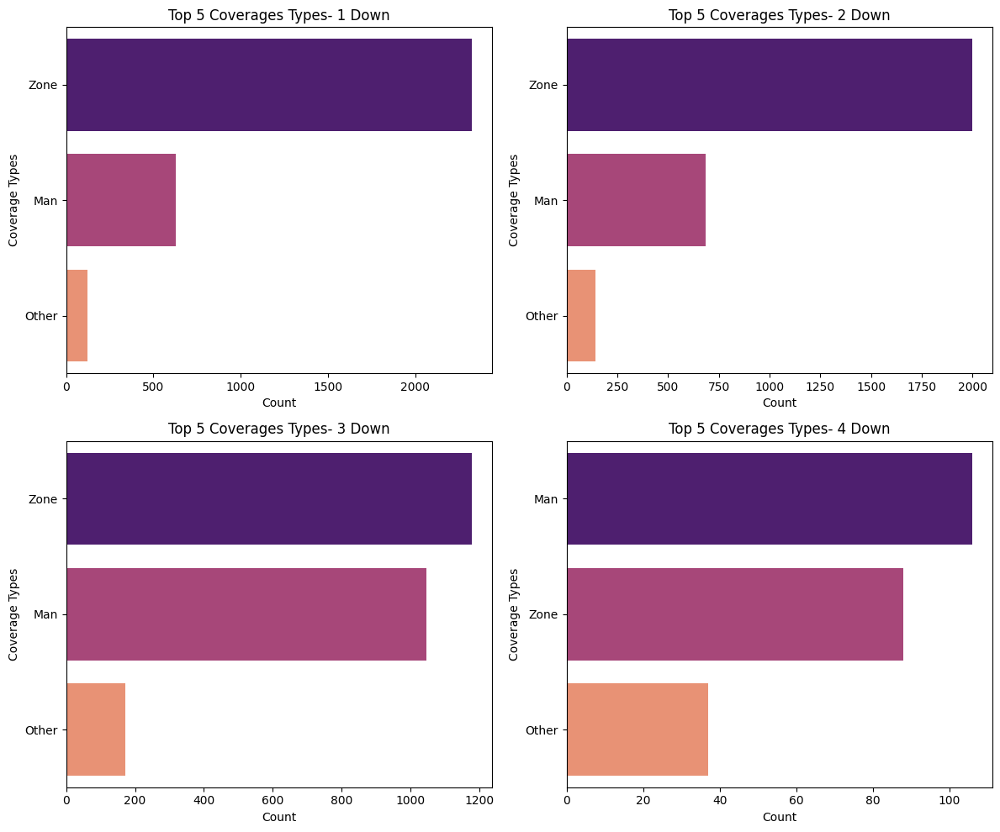

In [ ]:
# Define the downs of interest
downs = [1, 2, 3, 4]

# Create a subplot with 2 rows and 2 columns
fig, axes = plt.subplots(2, 2, figsize=(12, 10))

# Iterate over the downs and plot the top 5 personnel for each down
for i, down in enumerate(downs):
    # Filter the DataFrame for the current down
    down_df = game_play[game_play['down'] == down]

    # Get the top 5 personnel for the current down based on frequency
    top_5_coverage_types = down_df['pff_passCoverageType'].value_counts().nlargest(5)

    # Create a bar plot using Seaborn
    sns.barplot(ax=axes[i // 2, i % 2], x=top_5_coverage_types.values, y=top_5_coverage_types.index, palette="magma")

    # Customize the plot
    axes[i // 2, i % 2].set_title(f"Top 5 Coverages Types- {down} Down")
    axes[i // 2, i % 2].set_xlabel("Count")
    axes[i // 2, i % 2].set_ylabel("Coverage Types")

# Adjust the spacing between subplots
plt.tight_layout()

# Display the plot
plt.show()


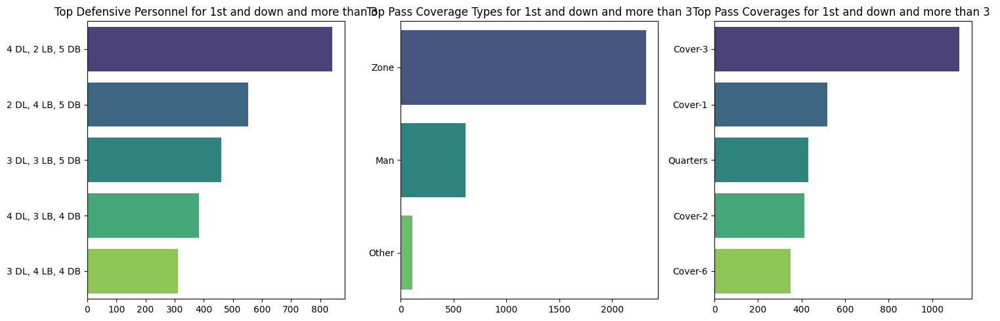

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Filter the DataFrame for 1st down and more than 3 yards
down_yards_filter = (game_play['down'] == 1) & (game_play['yardsToGo'] > 3)
filtered_df = game_play[down_yards_filter]

# Get the top personnel for 1st down and more than 3 yards
top_personnelD = filtered_df['personnelD'].value_counts().nlargest(5)
top_passCoverageType = filtered_df['pff_passCoverageType'].value_counts().nlargest(5)
top_passCoverage = filtered_df['pff_passCoverage'].value_counts().nlargest(5)

# Create a figure with three subplots
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot the top defensive personnel for 1st down and more than 3 yards
sns.barplot(ax=axes[0], x=top_personnelD.values, y=top_personnelD.index, palette="viridis")
axes[0].set_title("Top Defensive Personnel for 1st and down and more than 3")

# Plot the top pass coverage types for 1st down and more than 3 yards
sns.barplot(ax=axes[1], x=top_passCoverageType.values, y=top_passCoverageType.index, palette="viridis")
axes[1].set_title("Top Pass Coverage Types for 1st and down and more than 3")

# Plot the top pass coverages for 1st down and more than 3 yards
sns.barplot(ax=axes[2], x=top_passCoverage.values, y=top_passCoverage.index, palette="viridis")
axes[2].set_title("Top Pass Coverages for 1st and down and more than 3 ")

# Adjust the layout
plt.tight_layout()

# Display the plot
plt.show()


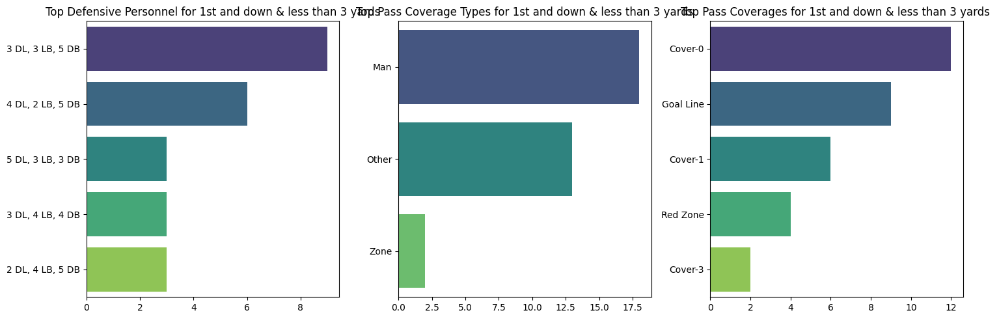

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Filter the DataFrame for 1st down and more than 3 yards
down_yards_filter = (game_play['down'] == 1) & (game_play['yardsToGo'] <= 3)
filtered_df = game_play[down_yards_filter]

# Get the top personnel for 1st down and more than 3 yards
top_personnelD = filtered_df['personnelD'].value_counts().nlargest(5)
top_passCoverageType = filtered_df['pff_passCoverageType'].value_counts().nlargest(5)
top_passCoverage = filtered_df['pff_passCoverage'].value_counts().nlargest(5)

# Create a figure with three subplots
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot the top defensive personnel for 1st down and more than 3 yards
sns.barplot(ax=axes[0], x=top_personnelD.values, y=top_personnelD.index, palette="viridis")
axes[0].set_title("Top Defensive Personnel for 1st and down & less than 3 yards")

# Plot the top pass coverage types for 1st down and more than 3 yards
sns.barplot(ax=axes[1], x=top_passCoverageType.values, y=top_passCoverageType.index, palette="viridis")
axes[1].set_title("Top Pass Coverage Types for 1st and down & less than 3 yards")

# Plot the top pass coverages for 1st down and more than 3 yards
sns.barplot(ax=axes[2], x=top_passCoverage.values, y=top_passCoverage.index, palette="viridis")
axes[2].set_title("Top Pass Coverages for 1st and down & less than 3 yards ")

# Adjust the layout
plt.tight_layout()

# Display the plot
plt.show()


In [ ]:
top_personnelD = game_play['passResult'].value_counts().nlargest(5)
top_personnelD

C     4620
I     2755
S      543
R      449
IN     190
Name: passResult, dtype: int64

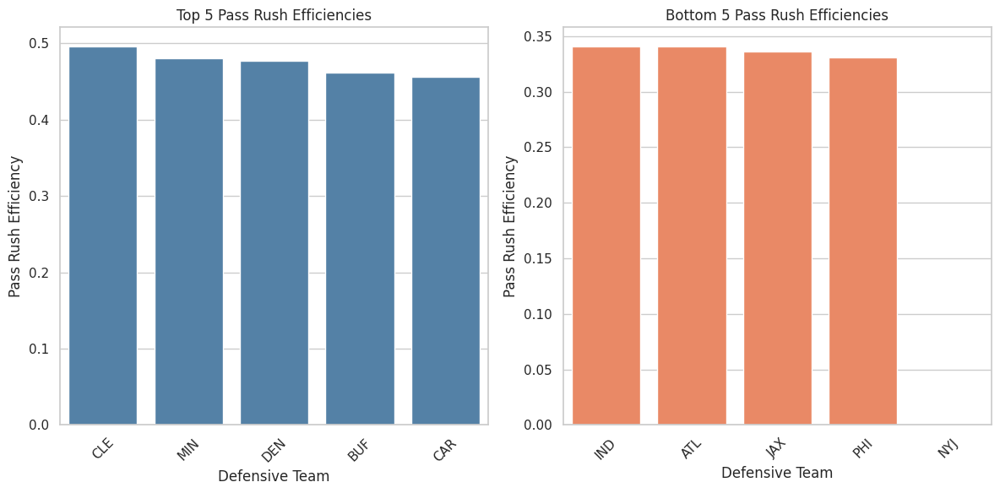

In [24]:
import matplotlib.pyplot as plt
import seaborn as sns

# Filter pass plays
pass_plays = game_play[(game_play['passResult'].isin(['C', 'I', 'S', 'R', 'IN']))]

# Count pass plays defended by each team
pass_plays_defended = pass_plays.groupby('defensiveTeam').size()

# Calculate pass rush statistics
sacks = pass_plays[pass_plays['passResult'] == 'S'].groupby('defensiveTeam').size()
incomplete = pass_plays[pass_plays['passResult'] == 'I'].groupby('defensiveTeam').size()
interceptions = pass_plays[pass_plays['passResult'] == 'IN'].groupby('defensiveTeam').size()

# Calculate pass rush efficiency
pass_rush_efficiency = (sacks + incomplete + interceptions) / pass_plays_defended

# Sort the results by pass rush efficiency in descending order
pass_rush_efficiency = pass_rush_efficiency.sort_values(ascending=False)

# Select top 5 and bottom 5 pass rush efficiencies
top_pass_rush_efficiency = pass_rush_efficiency.head(5)
bottom_pass_rush_efficiency = pass_rush_efficiency.tail(5)

# Set the style
sns.set(style="whitegrid")

# Create the figure and axes
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))

# Plot the top 5 pass rush efficiencies
sns.barplot(ax=axes[0], x=top_pass_rush_efficiency.index, y=top_pass_rush_efficiency, color='steelblue')
axes[0].set_title('Top 5 Pass Rush Efficiencies')
axes[0].set_xlabel('Defensive Team')
axes[0].set_ylabel('Pass Rush Efficiency')
axes[0].tick_params(axis='x', rotation=45)

# Plot the bottom 5 pass rush efficiencies
sns.barplot(ax=axes[1], x=bottom_pass_rush_efficiency.index, y=bottom_pass_rush_efficiency, color='coral')
axes[1].set_title('Bottom 5 Pass Rush Efficiencies')
axes[1].set_xlabel('Defensive Team')
axes[1].set_ylabel('Pass Rush Efficiency')
axes[1].tick_params(axis='x', rotation=45)

# Adjust the spacing between subplots
plt.tight_layout()

# Display the plot
plt.show()


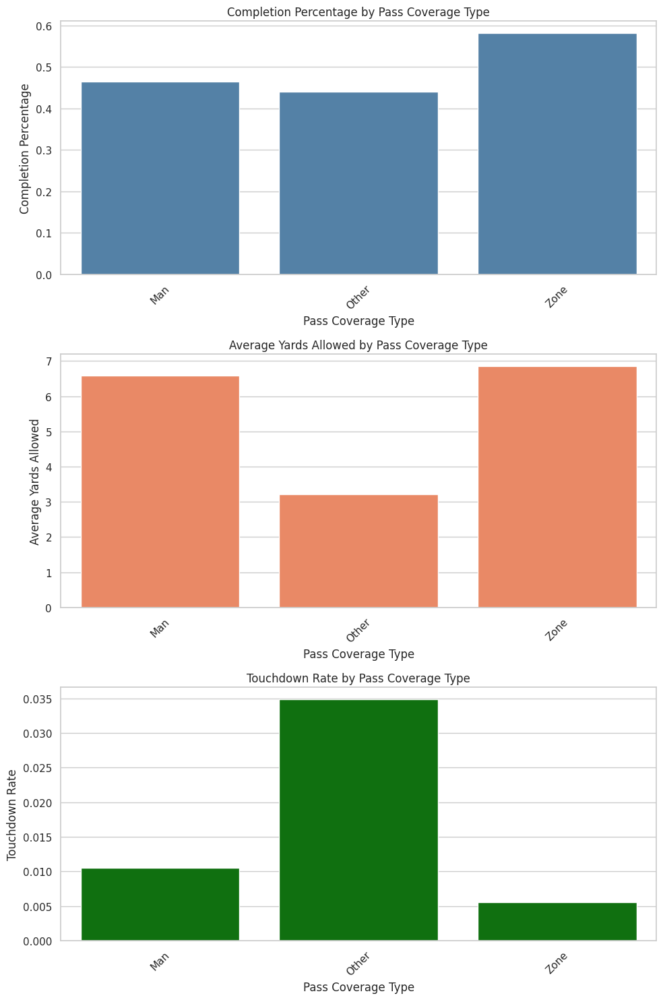

In [28]:
import matplotlib.pyplot as plt
import seaborn as sns

# Filter pass plays and select relevant columns
pass_plays = game_play[['passResult', 'pff_passCoverageType', 'preSnapHomeScore', 'preSnapVisitorScore', 'playResult','possessionTeam']]

# Group by pass coverage type
coverage_stats = pass_plays.groupby('pff_passCoverageType').agg({
    'passResult': 'count',
    'playResult': 'mean',
    'preSnapHomeScore': 'mean',
    'preSnapVisitorScore': 'mean'
})

# Rename the columns
coverage_stats.rename(columns={
    'passResult': 'Pass Plays Defended',
    'playResult': 'Average Yards Allowed',
    'preSnapHomeScore': 'Average Home Score',
    'preSnapVisitorScore': 'Average Visitor Score'
}, inplace=True)

# Calculate completion percentage
coverage_stats['Completion Percentage'] = pass_plays[pass_plays['passResult'] == 'C'].groupby('pff_passCoverageType').size() / coverage_stats['Pass Plays Defended']

# Calculate touchdown rate
coverage_stats['Touchdown Rate'] = ((pass_plays['possessionTeam'] == game_play['homeTeamAbbr']) & (pass_plays['preSnapHomeScore'] - pass_plays['preSnapHomeScore'].shift(1) >= 6) |
                                    (pass_plays['possessionTeam'] == game_play['visitorTeamAbbr']) & (pass_plays['preSnapVisitorScore'] - pass_plays['preSnapVisitorScore'].shift(1) >= 6)).groupby(pass_plays['pff_passCoverageType']).sum() / coverage_stats['Pass Plays Defended']


# Set the style
sns.set(style="whitegrid")

# Create the figure and axes
fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(10, 15))

# Plot completion percentage
sns.barplot(ax=axes[0], x=coverage_stats.index, y=coverage_stats['Completion Percentage'], color='steelblue')
axes[0].set_title('Completion Percentage by Pass Coverage Type')
axes[0].set_xlabel('Pass Coverage Type')
axes[0].set_ylabel('Completion Percentage')
axes[0].tick_params(axis='x', rotation=45)

# Plot average yards allowed
sns.barplot(ax=axes[1], x=coverage_stats.index, y=coverage_stats['Average Yards Allowed'], color='coral')
axes[1].set_title('Average Yards Allowed by Pass Coverage Type')
axes[1].set_xlabel('Pass Coverage Type')
axes[1].set_ylabel('Average Yards Allowed')
axes[1].tick_params(axis='x', rotation=45)

# Plot touchdown rate
sns.barplot(ax=axes[2], x=coverage_stats.index, y=coverage_stats['Touchdown Rate'], color='green')
axes[2].set_title('Touchdown Rate by Pass Coverage Type')
axes[2].set_xlabel('Pass Coverage Type')
axes[2].set_ylabel('Touchdown Rate')
axes[2].tick_params(axis='x', rotation=45)

# Adjust the spacing between subplots
plt.tight_layout()

# Display the plot
plt.show()


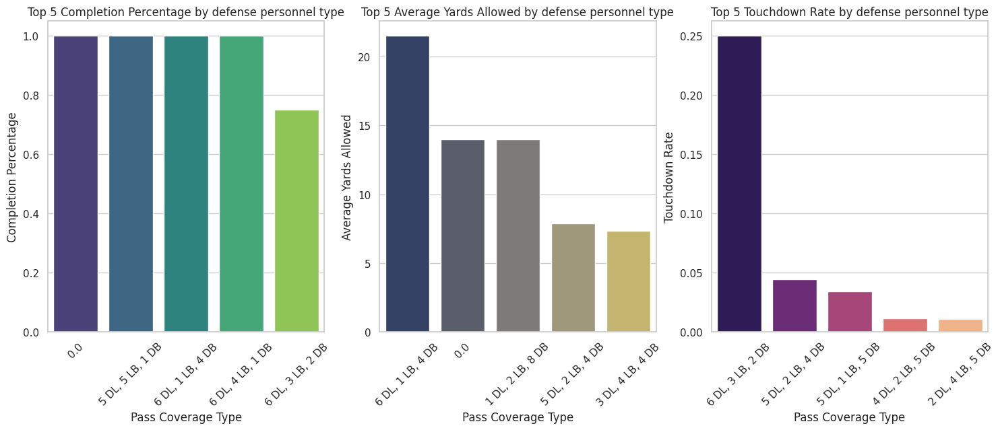

In [39]:
import matplotlib.pyplot as plt
import seaborn as sns

# Filter pass plays and select relevant columns
pass_plays = game_play[['passResult', 'personnelD', 'preSnapHomeScore', 'preSnapVisitorScore', 'playResult', 'possessionTeam']]

# Group by pass coverage type
coverage_stats = pass_plays.groupby('personnelD').agg({
    'passResult': 'count',
    'playResult': 'mean',
    'preSnapHomeScore': 'mean',
    'preSnapVisitorScore': 'mean'
})

# Rename the columns
coverage_stats.rename(columns={
    'passResult': 'Pass Plays Defended',
    'playResult': 'Average Yards Allowed',
    'preSnapHomeScore': 'Average Home Score',
    'preSnapVisitorScore': 'Average Visitor Score'
}, inplace=True)

# Calculate completion percentage
coverage_stats['Completion Percentage'] = pass_plays[pass_plays['passResult'] == 'C'].groupby('personnelD').size() / coverage_stats['Pass Plays Defended']

# Calculate touchdown rate
coverage_stats['Touchdown Rate'] = ((pass_plays['possessionTeam'] == game_play['homeTeamAbbr']) & (pass_plays['preSnapHomeScore'] - pass_plays['preSnapHomeScore'].shift(1) >= 6) |
                                    (pass_plays['possessionTeam'] == game_play['visitorTeamAbbr']) & (pass_plays['preSnapVisitorScore'] - pass_plays['preSnapVisitorScore'].shift(1) >= 6)).groupby(pass_plays['personnelD']).sum() / coverage_stats['Pass Plays Defended']

# Sort each column from highest to lowest
coverage_stats.sort_values(by='Completion Percentage', ascending=False, inplace=True)
top_completion_percentage = coverage_stats.head(5)

coverage_stats.sort_values(by='Average Yards Allowed', ascending=False, inplace=True)
top_average_yards_allowed = coverage_stats.head(5)

coverage_stats.sort_values(by='Touchdown Rate', ascending=False, inplace=True)
top_touchdown_rate = coverage_stats.head(5)

# Set the style
sns.set(style="whitegrid")

# Create the figure and axes
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(18, 6))

# Plot top completion percentage
sns.barplot(ax=axes[0], x=top_completion_percentage.index, y=top_completion_percentage['Completion Percentage'], palette='viridis')
axes[0].set_title('Top 5 Completion Percentage by defense personnel type')
axes[0].set_xlabel('Pass Coverage Type')
axes[0].set_ylabel('Completion Percentage')
axes[0].tick_params(axis='x', rotation=45)

# Plot top average yards allowed
sns.barplot(ax=axes[1], x=top_average_yards_allowed.index, y=top_average_yards_allowed['Average Yards Allowed'], palette='cividis')
axes[1].set_title('Top 5 Average Yards Allowed by defense personnel type')
axes[1].set_xlabel('Pass Coverage Type')
axes[1].set_ylabel('Average Yards Allowed')
axes[1].tick_params(axis='x', rotation=45)

# Plot top touchdown rate
sns.barplot(ax=axes[2], x=top_touchdown_rate.index, y=top_touchdown_rate['Touchdown Rate'], palette='magma')
axes[2].set_title('Top 5 Touchdown Rate by defense personnel type')
axes[2].set_xlabel('Pass Coverage Type')
axes[2].set_ylabel('Touchdown Rate')
axes[2].tick_params(axis='x', rotation=45)
#
